# Capstone Project

## Background

We are glad you have successfully reached the capstone project part of "Data Science Fundamentals" course. You will put everything 
you have learned so far about data science to work. The outcome of this module should potentially serve as your portfolio item.

Unlike with previous projects, this time you are free to choose a dataset to explore from three suggested ones. As you will have to solve a provided problem, there will not be list of predefined questions that you have to answer - be creative and explore any dimensions of data you deem worth analyzing.

Although this might seem scary, this is how data science looks like in the industry. Often, it's your responsibility to not only give answers using the data, but also raise questions. The more creatively you look at this project, the better. Good luck!

----

## Requirements

Whichever problem you choose to analyze, general requirements are as follows:

#### Exploratory Data Analysis
* Describe the data with basic statistical parameters - mean, median, quantiles, etc. Use parameters that give you the most important statistical insights of the data.
* Grouping the data and analyzing the groups - using Pandas aggregate methods.
* Work with features - handle missing data if needed, use pandas date APIs.
* Manipulate datasets - use joins in needed.
* Visualize the data - you can use line, scatter, histogram plots, density plots, regplots, etc.

#### Statistical hypothesis testing
* Use at least one statistical significance test.
* Report p-values.
* Use visualizations.

#### Modeling
* Visualize data with dimensionality reduction algorithms.
* Perform cluster analysis.
* Use a linear model to explain relationships and predict new values.

#### Presentation
* Present the project - the data, methods and results.

## Problems

#### COVID-19 crisis 

<div><img width="400px" height="auto" src="https://images.unsplash.com/photo-1574515944794-d6dedc7150de?ixlib=rb-1.2.1&ixid=MXwxMjA3fDB8MHxwaG90by1wYWdlfHx8fGVufDB8fHw%3D&auto=format&fit=crop&w=1532&q=80" /></div>

The world is still struggling with one the most rapidly spreading pandemics. There are a lot of people who say that data is the best weapon we can use in this "Corona Fight". 

Imagine that you are one of the best data scientists in your country. The president of your country asked you to analyze the COVID-19 patient-level data of South Korea and prepare your homeland for the next wave of the pandemic. You, as the lead data scientist of your country **have to create and prove a plan of fighting the pandemics in your country** by analyzing the provided data. You must get most important insights using learned data science techniques and present them to the lead of your country.

https://www.kaggle.com/kimjihoo/coronavirusdataset/

#### 2016 US presidential elections

<div><img width="400px" height="auto" src="https://images.unsplash.com/photo-1583340806569-6da3d5ea9911?ixlib=rb-1.2.1&ixid=MXwxMjA3fDB8MHxwaG90by1wYWdlfHx8fGVufDB8fHw%3D&auto=format&fit=crop&w=1315&q=80" /></div>

In 2016, Donald Trump lost the popular vote, yet he won the electoral vote, securing 4 years in the Oval Office. This has been a shock to democrat supporters all around the world.

Imagine you travel back in time to 2016. As soon as you step out of your time-capsule, the Democratic Party hires you. They want you, the best data scientist across the time and space, **to explain what happened and what should have been done differently**. They want you to **prepare them for 2020 presidential elections**.

The Party has some tips for you - inspect the voters. What are Trump supporters? What do they feature? What are our supporters? Where should focus next? Any pro-trump states? Cities?

The Democrats were kind of enough to share [a Kaggle dataset](https://www.kaggle.com/benhamner/2016-us-election) with you on 2016 U.S. elections. Use the data to help the Democrats.

#### Fatal Police Shooting in United States

<div><img width="400px" height="auto" src="https://images.unsplash.com/photo-1606352466047-7cef02b312bb?ixlib=rb-1.2.1&ixid=MXwxMjA3fDB8MHxwaG90by1wYWdlfHx8fGVufDB8fHw%3D&auto=format&fit=crop&w=1662&q=80" /></div>

[Police brutality in the United States](https://en.wikipedia.org/wiki/Police_brutality_in_the_United_States) has been a nationwide issue since the 20th century. Public safety of U.S. citizens is a typical argument to justify the controversially high number of fatal shootings.

You are a contractor to the United States Department of Justice. **You have been given a case to investigate fatal police shootings throughout the United States of America, provide a list of issues, and propose a plan on how to tackle these issues**.

The department offered some tips - the public opinion indicates that there's something systematically fishy of police actions against civilians, some states differ from other, some cities are different from others, race equality is still an unanswered question, there's some talk about huge spendings on police, rumors about mental issues of those getting shot. Government is all about prioritizing - use the data to list issues with the police activity and propose a plan which issues to tackle first and how.

You are given 1 dataset to start with. Try to search for more datasets to enrich your data analysis.

Here's the dataset:

* [Fatal Police Shootings in the U.S. '15 - '17](https://www.kaggle.com/washingtonpost/police-shootings).

## Evaluation Criteria

- Code quality
- Fulfillment of the idea
- Adherence to the requirements
- Delivery of the presentation

#### Statistical hypothesis testing
- Correct statistical test method is used, based on the situation.
- Reasoning on chosen statistical significance level.

#### Modeling

- Both PCA and T-SNE algorithms are used.

## Chosen problem

I decided to work on corona case. I'll try to see where people get sick, what determines if a person dies if they got sick and propose actions that could be taken./


## Imports

In [58]:
import itertools

import geopandas as gpd
from kneed import KneeLocator
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import numpy as np
import pandas as pd
import scipy.stats as st
import seaborn as sns
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.linear_model import LogisticRegression
from sklearn.manifold import TSNE
from sklearn.metrics import classification_report
from sklearn.preprocessing import OneHotEncoder, LabelEncoder
from statsmodels.stats.proportion import proportions_ztest

sns.set_theme("talk")

## EDA
### Cases

In [59]:
cases = pd.read_csv('data/Case.csv', index_col=0)
cases.head()

,province,city,group,infection_case,confirmed,latitude,longitude
case_id,,,,,,,
1000001,Seoul,Yongsan-gu,True,Itaewon Clubs,139,37.538621,126.992652
1000002,Seoul,Gwanak-gu,True,Richway,119,37.48208,126.901384
1000003,Seoul,Guro-gu,True,Guro-gu Call Center,95,37.508163,126.884387
1000004,Seoul,Yangcheon-gu,True,Yangcheon Table Tennis Club,43,37.546061,126.874209
1000005,Seoul,Dobong-gu,True,Day Care Center,43,37.679422,127.044374


In [60]:
cases.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 174 entries, 1000001 to 7000004
Data columns (total 7 columns):
 #   Column          Non-Null Count  Dtype 
---  ------          --------------  ----- 
 0   province        174 non-null    object
 1   city            174 non-null    object
 2   group           174 non-null    bool  
 3   infection_case  174 non-null    object
 4   confirmed       174 non-null    int64 
 5   latitude        174 non-null    object
 6   longitude       174 non-null    object
dtypes: bool(1), int64(1), object(5)
memory usage: 9.7+ KB


No data specifically marked as missing, but longitude and latitude that should be numerical are "objects".

In [61]:
cases.loc[:, ["longitude", "latitude"]]

,longitude,latitude
case_id,,
1000001,126.992652,37.538621
1000002,126.901384,37.48208
1000003,126.884387,37.508163
1000004,126.874209,37.546061
1000005,127.044374,37.679422
...,...,...
6100012,-,-
7000001,-,-
7000002,-,-


In [62]:
cases.replace('-', np.nan, inplace=True)
cases.loc[:, "longitude"] = cases.loc[:, "longitude"].astype(float)
cases.loc[:, "latitude"] = cases.loc[:, "latitude"].astype(float)
cases.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 174 entries, 1000001 to 7000004
Data columns (total 7 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   province        174 non-null    object 
 1   city            121 non-null    object 
 2   group           174 non-null    bool   
 3   infection_case  174 non-null    object 
 4   confirmed       174 non-null    int64  
 5   latitude        65 non-null     float64
 6   longitude       65 non-null     float64
dtypes: bool(1), float64(2), int64(1), object(3)
memory usage: 9.7+ KB


In [63]:
# shape files downloaded from www.diva-gis.org/ at 2021-01-08
korea_gdf = gpd.read_file('data/SK_maps/KOR_adm1.shp').to_crs(epsg=4326)[["NAME_1", "ENGTYPE_1", "geometry"]]
korea_gdf = korea_gdf.set_index("NAME_1")
korea_gdf.head()

,ENGTYPE_1,geometry
NAME_1,,
Busan,Metropolitan City,"MULTIPOLYGON (((128.99403 34.98180, 128.99403 ..."
Chungcheongbuk-do,Province,"POLYGON ((128.02734 37.15823, 128.03488 37.155..."
Chungcheongnam-do,Province,"MULTIPOLYGON (((126.52458 36.03625, 126.52458 ..."
Daegu,Metropolitan City,"POLYGON ((128.69171 35.96570, 128.69951 35.963..."
Daejeon,Metropolitan City,"POLYGON ((127.33807 36.45684, 127.35730 36.454..."


In [64]:
def plot_map_and_bars(data: gpd.GeoDataFrame, column: str, title, log=False):
    if log:
        norm = colors.LogNorm(vmin=data[column].min(), vmax=data[column].max())
    else:
        norm = colors.Normalize(vmin=data[column].min(), vmax=data[column].max())

    data = data.sort_values(column, ascending=False)

    fig = plt.figure(figsize=(20, 10))
    fig.suptitle(title, fontsize=24)

    ax = plt.subplot(1, 2, 1)
    data.plot(
        column=column,
        ax=ax,
        cmap=sns.color_palette("plasma", as_cmap=True),
        legend=True,
        norm=norm,
    )

    ax = plt.subplot(1, 2, 2)
    sns.barplot(data=data, x=column, y=data.index, ax=ax, log=log)  # I'd love to match bar colors with map colors

    plt.tight_layout()
    fig.show()

#### Number of covid cases by province

In [65]:
num_cases_by_province = cases.groupby("province").agg(count=("province", "count"))

cases_gdf = pd.merge(
    left=korea_gdf,
    right=num_cases_by_province,
    left_index=True,
    right_index=True,
)

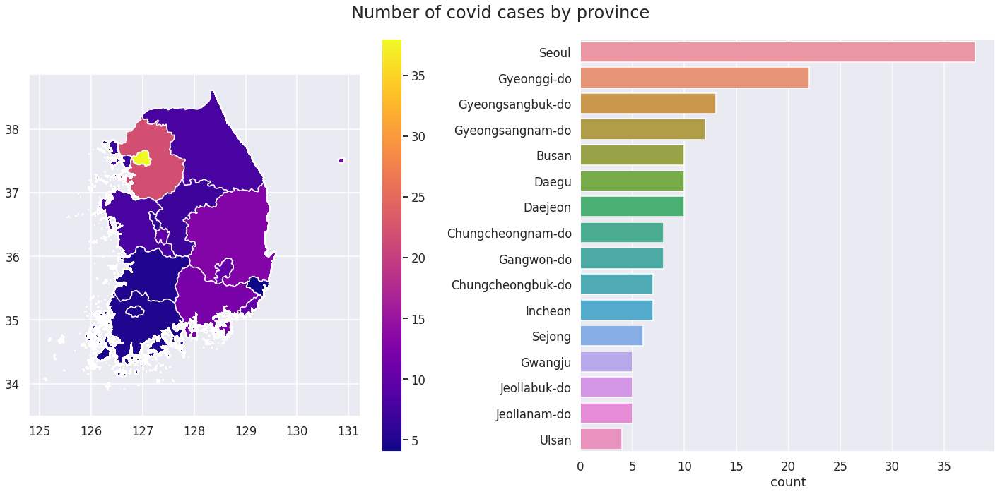

In [66]:
plot_map_and_bars(data=cases_gdf, column="count", title="Number of covid cases by province")

#### Number of people infected with covid by province

In [67]:
total_confirmed = cases.groupby("province")["confirmed"].sum()
total_confirmed_gdf = pd.merge(
    left=korea_gdf,
    right=total_confirmed,
    how="left",
    left_index=True,
    right_on="province"
).drop("province", axis="columns")
total_confirmed_gdf = total_confirmed_gdf.sort_values("confirmed", ascending=False)
total_confirmed_gdf.head()

,ENGTYPE_1,geometry,confirmed
Daegu,Metropolitan City,"POLYGON ((128.69171 35.96570, 128.69951 35.963...",6680.0
Gyeongsangbuk-do,Province,"MULTIPOLYGON (((129.42291 36.01875, 129.42291 ...",1324.0
Seoul,Capital Metropolitan City,"POLYGON ((127.05598 37.65949, 127.06171 37.654...",1280.0
Gyeonggi-do,Province,"MULTIPOLYGON (((126.72764 37.01431, 126.72764 ...",1000.0
Incheon,Metropolitan City,"MULTIPOLYGON (((129.04680 35.10125, 129.04680 ...",202.0


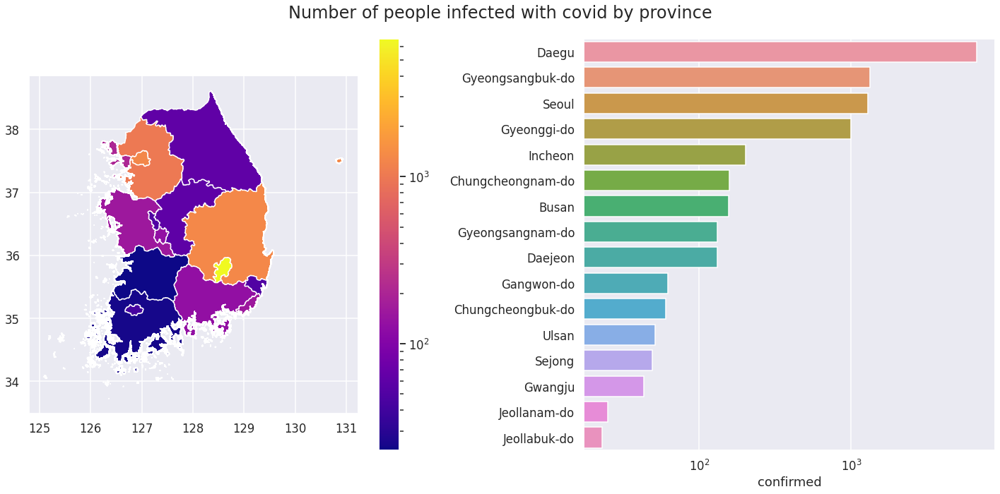

In [68]:
plot_map_and_bars(data=total_confirmed_gdf, column="confirmed", title="Number of people infected with covid by province", log=True)

#### Number of infections per 1000 pop

In [69]:
 # data taken from https://www.citypopulation.de/en/southkorea/cities/ accessed at 2021-01-09
population_df = pd.read_csv('data/Population.csv')
population_df.head()

,Name,Abbr.,Status,Capital,Area\nA (km²),Population\nEstimate (E)\n1992-12-31,Population\nEstimate (E)\n1997-12-31,Population\nEstimate (E)\n2002-12-31,Population\nEstimate (E)\n2007-12-31,Population\nEstimate (E)\n2012-12-31,Population\nEstimate (E)\n2017-12-31,Population\nEstimate (E)\n2019-12-31
0,Busan,BUS,MProv,Busan,768,3887278,3865114,3747369,3615101,3573533,3513490,3459840
1,Chungcheongbuk-do,CCB,Prov,Cheongju,7405,1404767,1475448,1501443,1527339,1590432,1631088,1640721
2,Chungcheongnam-do,CCN,Prov,Daejeon,8192,1786339,1822543,1835498,1944634,2074720,2180925,2194384
3,Daegu,DAG,MProv,Daegu,884,2286305,2501928,2540647,2512670,2527566,2501673,2468222
4,Daejeon,DAJ,MProv,Daejeon,540,1136621,1323009,1424844,1487836,1539154,1519658,1493979


In [70]:
latest_population_df = population_df.loc[:, ["Name", "Population\nEstimate (E)\n2019-12-31"]
].rename(columns={"Name": "province", "Population\nEstimate (E)\n2019-12-31": "2019_pop"})
latest_population_df.head()

,province,2019_pop
0,Busan,3459840
1,Chungcheongbuk-do,1640721
2,Chungcheongnam-do,2194384
3,Daegu,2468222
4,Daejeon,1493979


In [71]:
infections_per_pop_gdf = pd.merge(
    left=total_confirmed_gdf,
    right=latest_population_df,
    how="left",
    left_index=True,
    right_on="province"
).set_index("province")
infections_per_pop_gdf.loc[:, "infections_per_1000_pop"] = (
    infections_per_pop_gdf.confirmed / infections_per_pop_gdf.loc[:, "2019_pop"] * 1000
)
infections_per_pop_gdf.head()

,ENGTYPE_1,geometry,confirmed,2019_pop,infections_per_1000_pop
province,,,,,
Daegu,Metropolitan City,"POLYGON ((128.69171 35.96570, 128.69951 35.963...",6680.0,2468222.0,2.706402
Gyeongsangbuk-do,Province,"MULTIPOLYGON (((129.42291 36.01875, 129.42291 ...",1324.0,2723955.0,0.486058
Seoul,Capital Metropolitan City,"POLYGON ((127.05598 37.65949, 127.06171 37.654...",1280.0,10010983.0,0.127860
Gyeonggi-do,Province,"MULTIPOLYGON (((126.72764 37.01431, 126.72764 ...",1000.0,13653984.0,0.073239
Incheon,Metropolitan City,"MULTIPOLYGON (((129.04680 35.10125, 129.04680 ...",202.0,3029285.0,0.066682


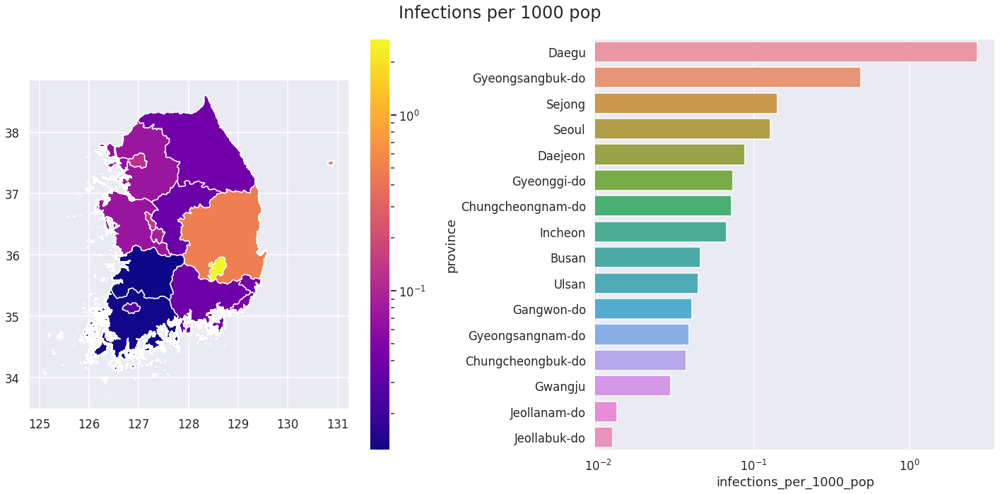

In [72]:
plot_map_and_bars(data=infections_per_pop_gdf, column="infections_per_1000_pop", title="Infections per 1000 pop", log=True)

Seoul does ok for its population size while Daegu did comparatively horrible.

#### Infection cases

What are cases? Province with highest number of cases doesn't have highest number of infected people.

Text(0.5, 1.02, 'Distribution of infection cases')

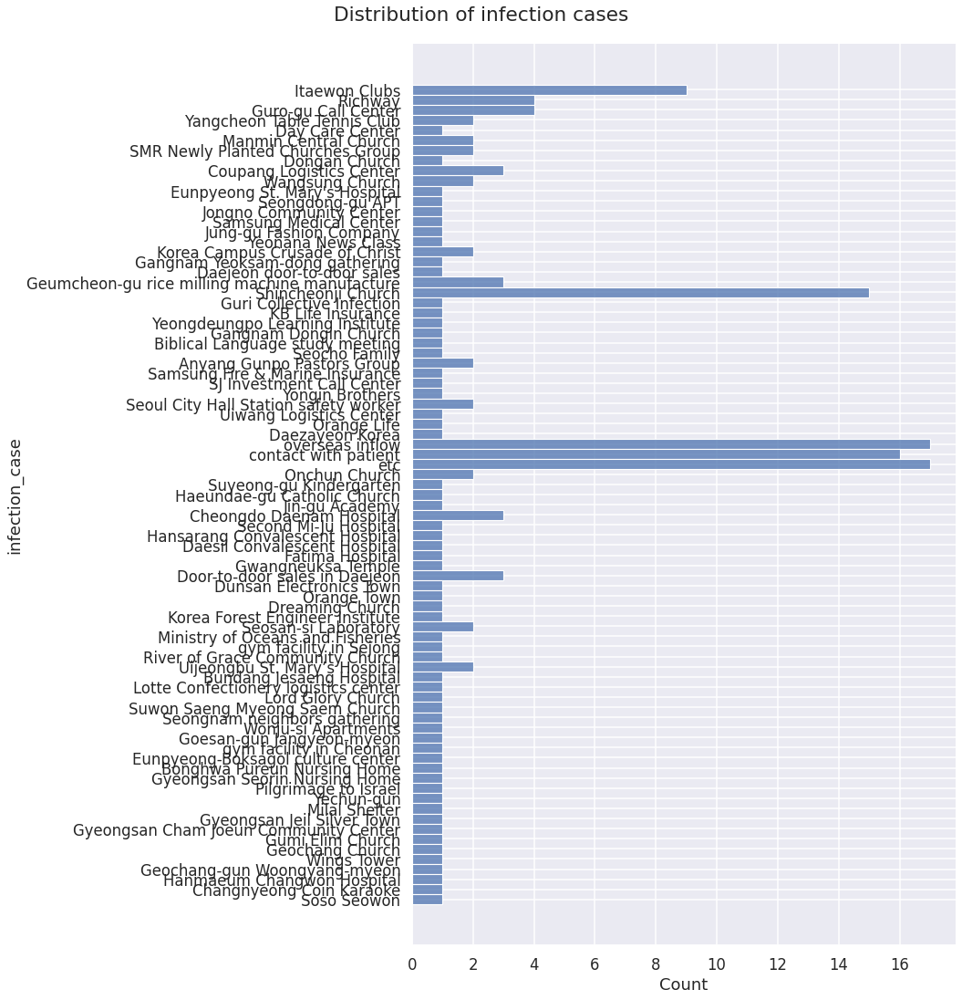

In [73]:
g = sns.displot(data=cases, y=cases.infection_case, kind="hist", height=15)
g.fig.suptitle('Distribution of infection cases', y=1.02)

After this graph and reading description of the data - infected_case seems to be:

1. a title of location where an outbreak happened when infections can be traced to a single event.
1.  
    - etc for unknown and ongoing investigations
    - overseas inflow for people arriving infected
    - contact with patient
    
So it seems like Seoul had a lot of small outbreaks while Daegu had several explosive ones. I'd love to commend South Korea's tracing program as it seems that majority of infections are traced down to a cause.

I'll group cases to better make sense of them.

In [74]:
cases.loc[:, "grouped_infection_case"] = cases.infection_case.replace({
 'Itaewon Clubs': "Recreation",
 'Richway': "Recreation",
 'Guro-gu Call Center': "Indoors work",
 'Yangcheon Table Tennis Club': "Recreation",
 'Day Care Center': "School",
 'Manmin Central Church': "Religious congregation",
 'SMR Newly Planted Churches Group': "Religious congregation",
 'Dongan Church': "Religious congregation",
 'Coupang Logistics Center': "Indoors work",
 'Wangsung Church': "Religious congregation",
 "Eunpyeong St. Mary's Hospital": "Hospital",
 'Seongdong-gu APT': "District",
 'Jongno Community Center': "Recreation",
 'Samsung Medical Center': "Hospital",
 'Jung-gu Fashion Company': "Indoors work",
 'Yeonana News Class': "School",
 'Korea Campus Crusade of Christ': "Religious congregation",
 'Gangnam Yeoksam-dong gathering': "Recreation",
 'Daejeon door-to-door sales': "Door-to-door sales",
 'Geumcheon-gu rice milling machine manufacture': "Indoors work",
 'Shincheonji Church': "Religious congregation",
 'Guri Collective Infection': "Recreation",
 'KB Life Insurance': "Indoors work",
 'Yeongdeungpo Learning Institute': "School",
 'Gangnam Dongin Church': "Religious congregation",
 'Biblical Language study meeting': "Religious congregation",
 'Seocho Family': "District",
 'Anyang Gunpo Pastors Group': "Religious congregation",
 'Samsung Fire & Marine Insurance': "Indoors work",
 'SJ Investment Call Center': "Indoors work",
 'Yongin Brothers': "District",
 'Seoul City Hall Station safety worker': "Indoors work",
 'Uiwang Logistics Center': "Indoors work",
 'Orange Life': "Indoors work",
 'Daezayeon Korea': "Door-to-door sales",
 'Onchun Church': "Religious congregation",
 'Suyeong-gu Kindergarten': "School",
 'Haeundae-gu Catholic Church': "Religious congregation",
 'Jin-gu Academy': "School",
 'Cheongdo Daenam Hospital': "Hospital",
 'Second Mi-Ju Hospital': "Hospital",
 'Hansarang Convalescent Hospital': "Hospital",
 'Daesil Convalescent Hospital': "Hospital",
 'Fatima Hospital': "Hospital",
 'Gwangneuksa Temple': "Religious congregation",
 'Door-to-door sales in Daejeon': "Door-to-door sales",
 'Dunsan Electronics Town': "District",
 'Orange Town': "District",
 'Dreaming Church': "Religious congregation",
 'Korea Forest Engineer Institute': "School",
 'Seosan-si Laboratory': "School",
 'Ministry of Oceans and Fisheries': "Indoors work",
 'gym facility in Sejong': "Recreation",
 'River of Grace Community Church': "Religious congregation",
 'Uijeongbu St. Mary’s Hospital': "Hospital",
 'Bundang Jesaeng Hospital': "Hospital",
 'Lotte Confectionery logistics center': "Indoors work",
 'Lord Glory Church': "Religious congregation",
 'Suwon Saeng Myeong Saem Church': "Religious congregation",
 'Seongnam neighbors gathering': "Recreation",
 'Wonju-si Apartments': "District",
 'Goesan-gun Jangyeon-myeon': "District",
 'gym facility in Cheonan': "Recreation",
 'Eunpyeong-Boksagol culture center': "Recreation",
 'Bonghwa Pureun Nursing Home': "Shelters and nursing homes",
 'Gyeongsan Seorin Nursing Home': "Shelters and nursing homes",
 'Pilgrimage to Israel': "Religious congregation",
 'Yechun-gun': "District",
 'Milal Shelter': "Shelters and nursing homes",
 'Gyeongsan Jeil Silver Town': "District",
 'Gyeongsan Cham Joeun Community Center': "Recreation",
 'Gumi Elim Church': "Religious congregation",
 'Geochang Church': "Religious congregation",
 'Wings Tower': "District",
 'Geochang-gun Woongyang-myeon': "District",
 'Hanmaeum Changwon Hospital': "Hospital",
 'Changnyeong Coin Karaoke': "Recreation",
 'Soso Seowon': "District",
 'etc': "Etc",
 "contact with patient": "Contact with patient",
 "overseas inflow": "Overseas inflow"
})
cases_count_by_infection_group = cases.groupby("grouped_infection_case").agg(
    count=("province", "count"), confirmed=("confirmed", "sum")
).reset_index()

Text(0.5, 1.05, 'Infected people per case type')

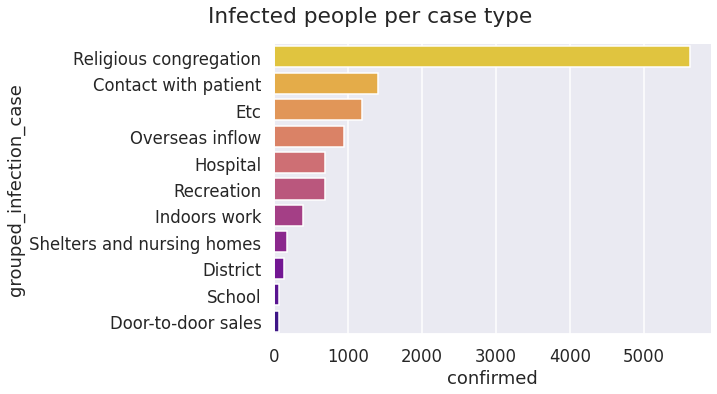

In [75]:
g = sns.catplot(
    data=cases_count_by_infection_group.sort_values("confirmed", ascending=False),
    x="confirmed",
    y="grouped_infection_case",
    kind="bar",
    height=5,
    aspect=2,
    palette="plasma_r"
)
g.fig.suptitle('Infected people per case type', y=1.05)

District - I googled that infection case title and google returned me a district. I.e., I failed to discern activity/location with greater clarity.

### Patient info

In [76]:
def age_to_number(x):
    try:
        return int(x[:-1])
    except Exception:
        return np.nan

patient_info = pd.read_csv('data/PatientInfo.csv', parse_dates=True, converters={"age": age_to_number})
patient_info.head()

,patient_id,sex,age,country,province,city,infection_case,infected_by,contact_number,symptom_onset_date,confirmed_date,released_date,deceased_date,state
0,1000000001,male,50.0,Korea,Seoul,Gangseo-gu,overseas inflow,NaN,75,2020-01-22,2020-01-23,2020-02-05,NaN,released
1,1000000002,male,30.0,Korea,Seoul,Jungnang-gu,overseas inflow,NaN,31,NaN,2020-01-30,2020-03-02,NaN,released
2,1000000003,male,50.0,Korea,Seoul,Jongno-gu,contact with patient,2002000001,17,NaN,2020-01-30,2020-02-19,NaN,released
3,1000000004,male,20.0,Korea,Seoul,Mapo-gu,overseas inflow,NaN,9,2020-01-26,2020-01-30,2020-02-15,NaN,released
4,1000000005,female,20.0,Korea,Seoul,Seongbuk-gu,contact with patient,1000000002,2,NaN,2020-01-31,2020-02-24,NaN,released


In [77]:
patient_info.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5165 entries, 0 to 5164
Data columns (total 14 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   patient_id          5165 non-null   int64  
 1   sex                 4043 non-null   object 
 2   age                 3785 non-null   float64
 3   country             5165 non-null   object 
 4   province            5165 non-null   object 
 5   city                5071 non-null   object 
 6   infection_case      4246 non-null   object 
 7   infected_by         1346 non-null   object 
 8   contact_number      791 non-null    object 
 9   symptom_onset_date  690 non-null    object 
 10  confirmed_date      5162 non-null   object 
 11  released_date       1587 non-null   object 
 12  deceased_date       66 non-null     object 
 13  state               5165 non-null   object 
dtypes: float64(1), int64(1), object(12)
memory usage: 565.0+ KB


Hm, I have information about less infections individually than I had for as part of an infection case. I have individual information for roughly half of infections. I'll have have to be very careful if I deal with:

1. infected_by
1. symptom_onset_date
1. released_date
1. contact_number

Significant amount of patients lack age and sex info as well. Ah well.

In [78]:
individual_infections_by_province = patient_info.groupby("province").agg(individual_count=("patient_id", "count"))
infections_by_province = individual_infections_by_province.join(total_confirmed)
infections_by_province

,individual_count,confirmed
province,,
Busan,151,156
Chungcheongbuk-do,56,60
Chungcheongnam-do,168,158
Daegu,137,6680
Daejeon,119,131
Gangwon-do,63,62
Gwangju,44,43
Gyeonggi-do,1208,1000
Gyeongsangbuk-do,1254,1324


In [79]:
st.chisquare(
    f_obs=infections_by_province.individual_count,
    f_exp=infections_by_province.confirmed
)

Power_divergenceResult(statistic=6558.292470994047, pvalue=0.0)

I don't simply have less information. Seems like I lauded South Korea's tracing too early. There are significant - both practical and statistical - variations with the kind of data I have from different provices. The most glaring difference is in infections in Daegu.

In [80]:
st.chisquare(
    f_obs=infections_by_province.drop("Daegu").individual_count,
    f_exp=infections_by_province.drop("Daegu").confirmed
)

Power_divergenceResult(statistic=149.48274045512596, pvalue=3.0561555311019777e-24)

So no, just dropping Daegu is not enough to say that whatever my findings are, they apply to whole South Korea (minus Daegu). My analysis of data for individual infections should be taken with a pound of salt due to data mismatch and a grain of pepper cause I may be stupid.

#### Are people without release date simply still sick?

Text(0.5, 0.98, "Distribution of patients' state")

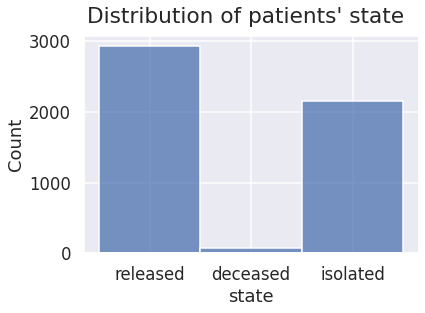

In [81]:
ax = sns.histplot(data=patient_info, x="state")
plt.suptitle("Distribution of patients' state")

In [82]:
patient_info.loc[patient_info.state == "released", "released_date"].isna().mean()

0.4609081597814954

Almost half of released patients don't have the date they are released marked.

### Do people of different ages get sick at the same rate?

Text(0.5, 1.02, 'Distribution of ages for individual patients')

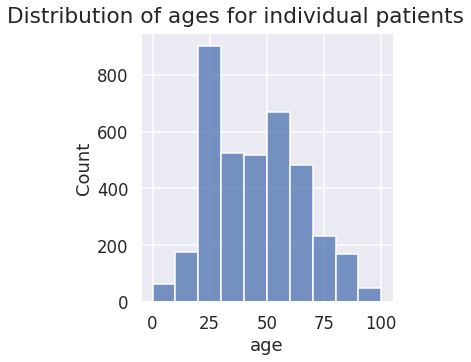

In [83]:
g = sns.displot(x=patient_info.age, binwidth=10)
g.fig.suptitle("Distribution of ages for individual patients", y=1.02)

People in their 20s seem overrepresented.
- are they more likely to catch the disease?
- are they disproportionally registered? - I do lack age data for ~20% of patients

Text(0.5, 1.02, 'Distribution of gender for individual patients')

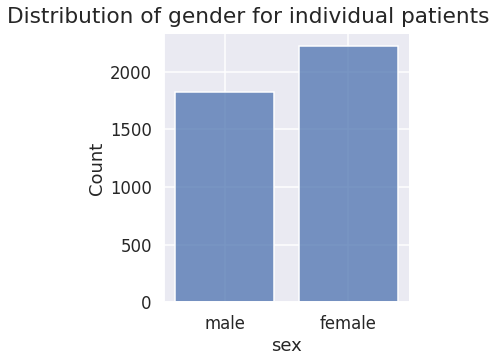

In [84]:
g = sns.displot(x=patient_info.sex.dropna(),shrink=.8, kind="hist")
g.fig.suptitle("Distribution of gender for individual patients", y=1.02)

So we have more females infected than males. Regrettably, I don't have data for negative covid results by gender, so I cannot determine why is that:
- do males test for covid less? A random sample of a population should be tested to check this
- do females have jobs/activities that put them more at risk of catching covid?
- perhaps males indeed have a lesser chance of catching covid from same exposure as females.

### TimeAge

In [85]:
time_age = pd.read_csv('data/TimeAge.csv', converters={"age": age_to_number}, parse_dates=True, index_col="date")
time_age.head()

,time,age,confirmed,deceased
date,,,,
2020-03-02,0,0,32,0
2020-03-02,0,10,169,0
2020-03-02,0,20,1235,0
2020-03-02,0,30,506,1
2020-03-02,0,40,633,1


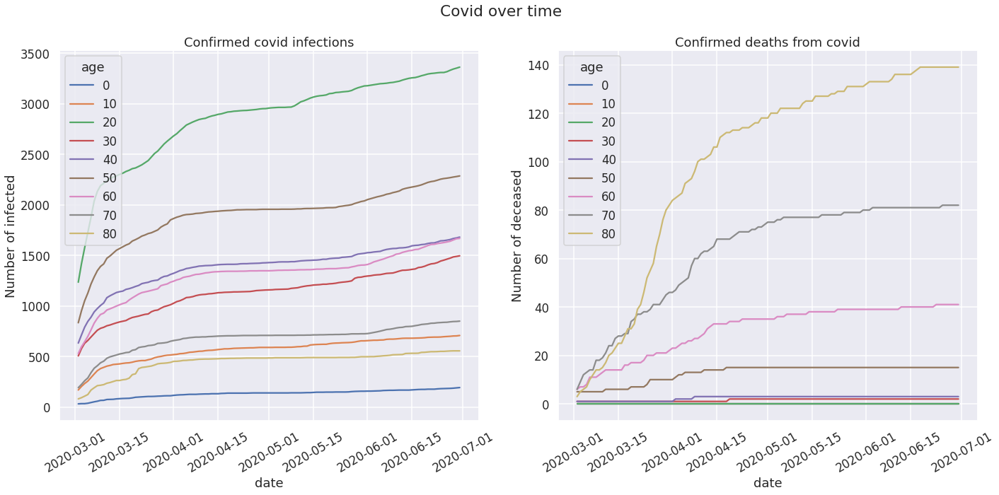

In [86]:
fig = plt.figure(figsize=(20, 10))
fig.suptitle("Covid over time")

ax = plt.subplot(1, 2, 1)
ax = sns.lineplot(data=time_age, x=time_age.index, y="confirmed", hue=time_age.age.astype(str), ax=ax)
ax.title.set_text("Confirmed covid infections")
ticks = plt.xticks(rotation=30)  # getting only month and day to show up would be nice
plt.ylabel("Number of infected")

ax = plt.subplot(1, 2, 2)
ax = sns.lineplot(data=time_age, x=time_age.index, y="deceased", hue=time_age.age.astype(str), ax=ax)
ax.title.set_text("Confirmed deaths from covid")
ticks = plt.xticks(rotation=30)  # getting only month and day to show up would be nice
plt.ylabel("Number of deceased")

plt.tight_layout()
fig.show()

Just taking data for last date we'll get information on total infections/deaths for age groups.

## Hypothesis testing

### Are older people more vulnerable to covid than youngsters?

Null hypothesis: young people die at the same rate or greater rate from covid than old people  
Alternative hypothesis: old people die from covid more often

I'll use 95% confidence interval (significance level p=0.05)

My analysis overstates survivability of covid. It counts everyone not dead as having survived the disease, even though they may currently be sick and die later.

In [87]:
young_cutoff = 30  # up to people in their 30s, ie., up to 39 yo
old_cutoff = 60   # from 60 yo

last_data = time_age.loc["2020-06-30"].reset_index().drop(["date", "time"], axis="columns")

age_cat = pd.cut(
    last_data.age,
    bins=[0, young_cutoff, old_cutoff, 1000],
    labels=["young", "middle-aged", "old"],
    include_lowest=True
)
last_data.loc[:, "age_cat"] = age_cat
last_data

,age,confirmed,deceased,age_cat
0,0,193,0,young
1,10,708,0,young
2,20,3362,0,young
3,30,1496,2,young
4,40,1681,3,middle-aged
5,50,2286,15,middle-aged
6,60,1668,41,middle-aged
7,70,850,82,old
8,80,556,139,old


In [88]:
grouped_by_age_cat = last_data.groupby("age_cat")[["confirmed", "deceased"]].sum()
grouped_by_age_cat

,confirmed,deceased
age_cat,,
young,5759,2
middle-aged,5635,59
old,1406,221


In [89]:
z_score, p_value = proportions_ztest(
    count=grouped_by_age_cat.loc[["young", "old"], "deceased"],
    nobs=grouped_by_age_cat.loc[["young", "old"], "confirmed"],
    alternative="smaller"  # death ratio of young people is smaller than death ratio of old people
)
print(f"Z score: {z_score}, p value: {p_value}")

Z score: -30.361688372370924, p value: 8.806688604744096e-203


We can safely reject null hypothesis in favor of alternative hypothesis that old people die from covid at a greater rate than young people. Interesting question now is, by how much?

In [90]:
death_ratio = (
    grouped_by_age_cat["deceased"] / (
        grouped_by_age_cat["confirmed"] + grouped_by_age_cat["deceased"]
    )
).to_frame("mean_ratio")
death_ratio

,mean_ratio
age_cat,
young,0.000347
middle-aged,0.010362
old,0.135833


In [91]:
death_ratio.loc["old", "mean_ratio"] / death_ratio.loc["young", "mean_ratio"]

391.2664413030117

So people in South Korea above 60 are more than 400 times likely to die from it than people below 30 due to catching Covid.

#### I'd love to see a range, say from ~300 to ~500 times more likely to die.

## What factors influence if a person dies?

So we've learnt that age strongly increases probability of dying. What else?

In [92]:
patient_info.head()

,patient_id,sex,age,country,province,city,infection_case,infected_by,contact_number,symptom_onset_date,confirmed_date,released_date,deceased_date,state
0,1000000001,male,50.0,Korea,Seoul,Gangseo-gu,overseas inflow,NaN,75,2020-01-22,2020-01-23,2020-02-05,NaN,released
1,1000000002,male,30.0,Korea,Seoul,Jungnang-gu,overseas inflow,NaN,31,NaN,2020-01-30,2020-03-02,NaN,released
2,1000000003,male,50.0,Korea,Seoul,Jongno-gu,contact with patient,2002000001,17,NaN,2020-01-30,2020-02-19,NaN,released
3,1000000004,male,20.0,Korea,Seoul,Mapo-gu,overseas inflow,NaN,9,2020-01-26,2020-01-30,2020-02-15,NaN,released
4,1000000005,female,20.0,Korea,Seoul,Seongbuk-gu,contact with patient,1000000002,2,NaN,2020-01-31,2020-02-24,NaN,released


In [93]:
age_cat = pd.cut(
    patient_info.age,
    bins=[0, young_cutoff, old_cutoff, 1000],
    labels=["young", "middle-aged", "old"],
    include_lowest=True
)
patient_info.loc[:, "age_cat"] = age_cat
assert (patient_info.dropna(subset=["age_cat"]).index == patient_info.dropna(subset=["age"]).index).all()
patient_info.loc[:, "age_cat"] = patient_info.age_cat.cat.add_categories('Unknown')

In [94]:
infection_case_groupings = cases[["infection_case", "grouped_infection_case"]]
infection_case_groupings = infection_case_groupings.groupby("infection_case")["grouped_infection_case"].max()
infection_case_groupings

infection_case
Anyang Gunpo Pastors Group             Religious congregation
Biblical Language study meeting        Religious congregation
Bonghwa Pureun Nursing Home        Shelters and nursing homes
Bundang Jesaeng Hospital                             Hospital
Changnyeong Coin Karaoke                           Recreation
                                              ...            
contact with patient                     Contact with patient
etc                                                       Etc
gym facility in Cheonan                            Recreation
gym facility in Sejong                             Recreation
overseas inflow                               Overseas inflow
Name: grouped_infection_case, Length: 81, dtype: object

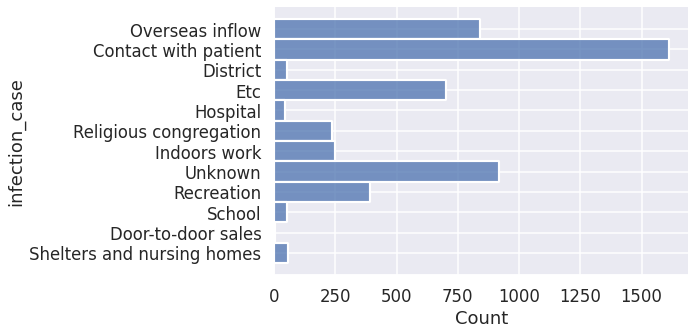

In [95]:
ic = patient_info.infection_case.copy()
ic.replace(infection_case_groupings, inplace=True)
ic.fillna("Unknown", inplace=True)
sns.displot(y=ic, aspect=2)

Hm, from the data that included Daegu we saw that majority of infections happen in religious congregations. In this graph religious congregation isn't enough to overtake contact with patient, so it seems that we lack tracing data from religious congregations that happened mostly in Daegu. Also hospital infections seem underrepresented.

In [96]:
patient_info.loc[:, "grouped_infection_case"] = ic
patient_info.loc[:, ["sex", "age_cat"]] = patient_info[["sex", "age_cat"]].fillna("Unknown")
# there is some data leakage here, hopefully w/e
one_hot_encoder = OneHotEncoder().fit(patient_info[["province", "sex", "grouped_infection_case", "age_cat"]])
categorical_features = one_hot_encoder.transform(patient_info[["province", "sex", "grouped_infection_case", "age_cat"]]).todense()
print(categorical_features.shape)
print(categorical_features[:5])

(5165, 36)
[[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0.
  0. 0. 1. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0.
  0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 1. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 0. 1. 0. 0. 0. 0.
  0. 0. 1. 0. 0. 0. 0. 0. 0. 0. 0. 1.]
 [0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1. 0. 0. 1. 0. 1. 0. 0. 0.
  0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 1.]]


In [97]:
# drop features about "isolated" states
states = patient_info.loc[patient_info.state != "isolated", "state"]
categorical_features = categorical_features[states.index]
categorical_features.shape

(3007, 36)

### Visualization

Text(15.439999999999998, 0.5, 'Proportion of explained variance')

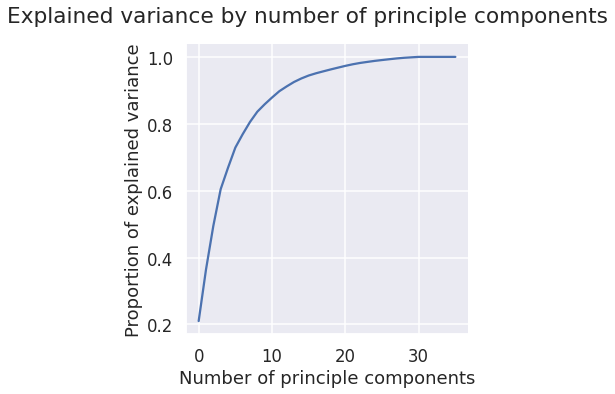

In [98]:
pca = PCA().fit(categorical_features)
cumul_variance_explained = np.cumsum(pca.explained_variance_ratio_)
g = sns.relplot(
    x=range(pca.n_components_),
    y=cumul_variance_explained,
    kind="line"
)
g.fig.suptitle("Explained variance by number of principle components", y=1.05)
g.axes[0, 0].set_xlabel("Number of principle components")
g.axes[0, 0].set_ylabel("Proportion of explained variance")

In [99]:
cumul_variance_explained[2]

0.4948424327478484

Hm, first two principal components explain just a tad under 50% of variance. Let's see what we get.

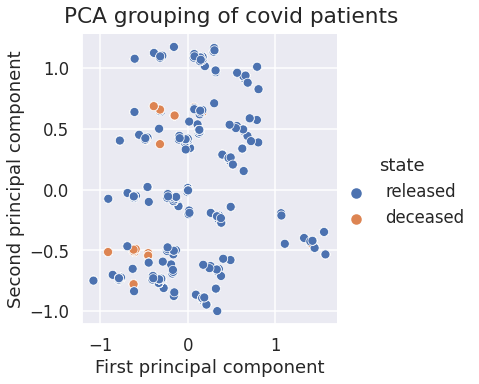

In [100]:
pca_features = pca.transform(categorical_features)
g = sns.relplot(x=pca_features[:, 0], y=pca_features[:, 1], hue=states)
g.fig.suptitle("PCA grouping of covid patients", y=1.02)
g.set_xlabels("First principal component")
g.set_ylabels("Second principal component")

By PCA, there's two groups of people that have higher probability to die. Let's see if t-SNE confirms that.

Text(0.5, 1.02, 'TSNE grouping of covid patients')

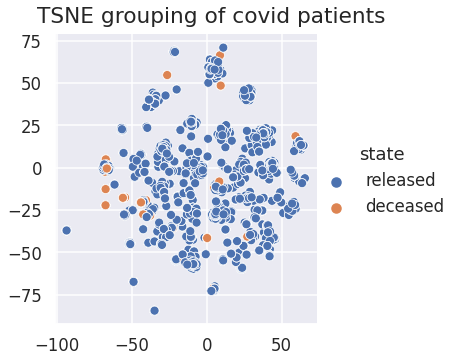

In [101]:
tsne_features = TSNE(perplexity=10).fit_transform(categorical_features)
g = sns.relplot(x=tsne_features[:, 0], y=tsne_features[:, 1], hue=states)
g.fig.suptitle("TSNE grouping of covid patients", y=1.02)

PCA did a better job of getting people that did die together.

Text(0.5, 0.98, 'Determening the number of clusters by elbow method')

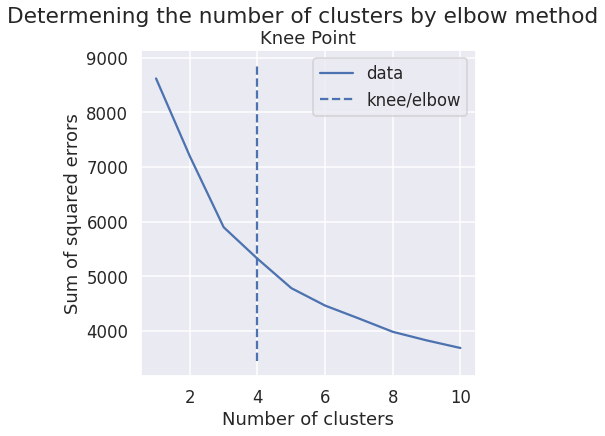

In [102]:
kmeans_kwargs = {  
        "init": "random",
        "n_init": 10,
        "max_iter": 300,
        "random_state": 42,
    }

squared_errors_sums = []
for k in range(1, 11):
  kmeans = KMeans(n_clusters=k, **kmeans_kwargs)
  kmeans.fit(categorical_features)
  squared_errors_sums.append(kmeans.inertia_)

kl = KneeLocator(
    range(1, 11), squared_errors_sums, curve="convex", direction="decreasing"
)

kl.plot_knee()
plt.xlabel("Number of clusters")
plt.ylabel("Sum of squared errors")
plt.suptitle("Determening the number of clusters by elbow method")

Using 4 clusters seems as reasonable of a decision as any other. Looking at the PCA graph, we might need 5 clusters, but let's see.

In [117]:
kmeans = KMeans(n_clusters=kl.elbow, **kmeans_kwargs)
result = kmeans.fit(categorical_features)

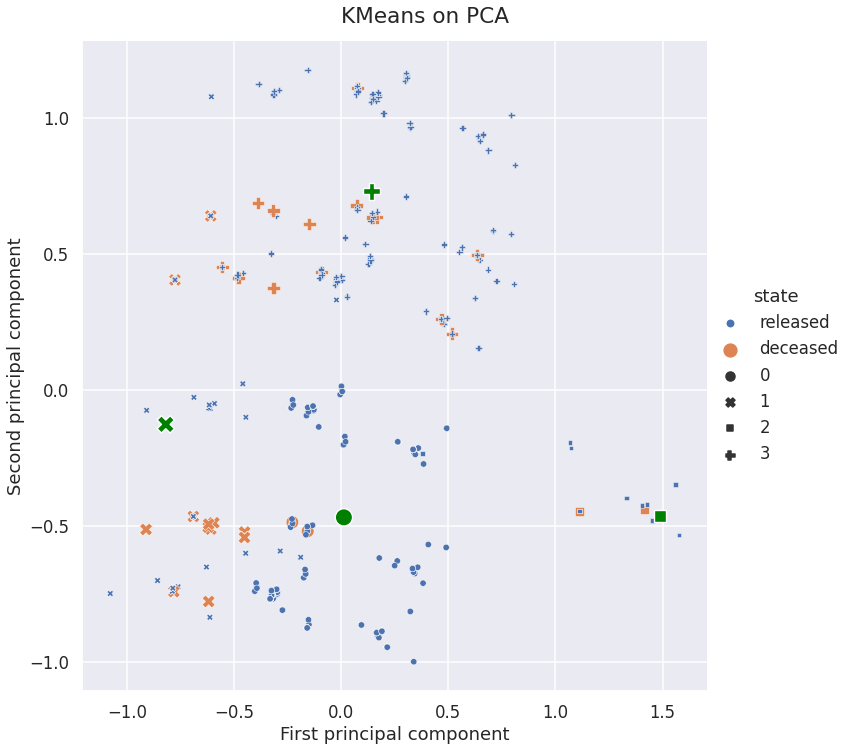

In [118]:
pca_centers = pca.transform(result.cluster_centers_)

palette = sns.color_palette("husl", 4)

g = sns.relplot(
    x=pca_features[:, 0],
    y=pca_features[:, 1],
    style=result.labels_,
    hue=states,
    size=states,
    size_order=["deceased", "released"],
    height=10,
#    palette=palette
)
cluster_centers = sns.scatterplot(
    x=pca_centers[:,0],
    y=pca_centers[:,1],
    style=np.unique(result.labels_),
    s=300,
    legend=False,
    color="green",
    #palette=palette,
)

g.fig.suptitle("KMeans on PCA", y=1.02)
g.set_xlabels("First principal component")
g.set_ylabels("Second principal component")

People that died from covid mostly fall into two different clusters with together with people that didn't die. There is a also a cluster 2 with relatively small number of people in it, some of which had died. Simple linear model is going to have a hard time predicting risk of death from covid ._.

## Linear model explaining death rates

In [127]:
indices = np.arange(categorical_features.shape[0])
np.random.shuffle(indices)
train_ratio = .8
train_indices = indices[:int(len(states) * train_ratio)]
test_indices = indices[int(len(states) * train_ratio):]
assert "deceased" in states.iloc[test_indices].unique()
encoded_states = states == "deceased"  # Ensure that deceased gets marked as event

In [128]:
model = LogisticRegression(fit_intercept=True)
model.fit(categorical_features[train_indices], encoded_states.iloc[train_indices])

LogisticRegression()

In [131]:
y_pred = model.predict(categorical_features[test_indices])
y_true = encoded_states.iloc[test_indices]

print(classification_report(y_true, y_pred, labels=[0, 1], target_names=["released", "deceased"]))

              precision    recall  f1-score   support

    released       0.98      1.00      0.99       588
    deceased       0.67      0.14      0.24        14

    accuracy                           0.98       602
   macro avg       0.82      0.57      0.61       602
weighted avg       0.97      0.98      0.97       602



This simple model does a pretty horrible job predicting who has higher risk to die from covid.

In [132]:
pd.DataFrame(data=np.exp(model.coef_[0]), index=features)

,0
Busan,1.261718
Chungcheongbuk-do,0.579924
Chungcheongnam-do,0.576872
Daegu,26.738325
Daejeon,1.246428
Gangwon-do,3.027537
Gwangju,0.893938
Gyeonggi-do,1.151351
Gyeongsangbuk-do,0.748118
Gyeongsangnam-do,0.481716


Catching virus in a hospital increases chances of dying from virus nearly seven times.

## Conclusion

#### How to prevent infections

Religious congregations are responsible for a majority of new infections. It'd be great if remote solutions could be found.  
After that the largest reason for new infections is contact with a patient. Contacts should be traced faster if possible so those that had contact with an infected wouldn't spread covid unknowlingly.  

Majority of infections happen indoors. Indoors gatherings should be limited and catching covid outdoors seems to be extremely unlikely.

#### How to prevent deaths from covid

Daegu's province hospitals seem overloaded. The single highest predictor for person dying seems to be whether they caught a disease in Daegu. That means new infections in Daegu must be prevented and I would say lockdowns limiting how many people can be in one place would be the most effective.

Then we get to vulnerable people.
- Old people
- People who are already in hospital due to covid unrelated health issues